# Visualization of inference results predicted by training model (our HR-Net)

In [1]:
# Dataset location (edit as needed)
root_dir = '/local_storage/datasets/sn7_winner_split'
pred_dir = '/local_storage/users/hfang/HRNet_SN7/output/spacenet7/seg_hrnet_w48_512x512_sgd_lr1e-2_wd4e-5_bs_16_epoch70/test_results/npy_compose'
winner_dir = '/local_storage/users/hfang/winner_docker/vis/test_org_compose'

In [2]:
import multiprocessing
import pandas as pd
import numpy as np
import skimage
import gdal
import sys
import os

import matplotlib as mpl
import matplotlib.cm as cmx
import matplotlib.pyplot as plt
import matplotlib.colors as colors
plt.rcParams.update({'font.size': 16})
mpl.rcParams['figure.dpi'] = 300

import solaris as sol
from solaris.raster.image import create_multiband_geotiff
from solaris.utils.core import _check_gdf_load

# import from data_prep_funcs
module_path = os.path.abspath(os.path.join('../src/'))
if module_path not in sys.path:
    sys.path.append(module_path)
from sn7_baseline_prep_funcs import map_wrapper, make_geojsons_and_masks

/Midgard/home/hfang/miniconda3/envs/solaris/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:526: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/Midgard/home/hfang/miniconda3/envs/solaris/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:527: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/Midgard/home/hfang/miniconda3/envs/solaris/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:528: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/Midgard/home/hfang

/local_storage/datasets/sn7_winner_split/test_public/L15-1200E-0847N_4802_4803_13/masks/global_monthly_2020_01_mosaic_L15-1200E-0847N_4802_4803_13_Buildings.tif
[[  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 ...
 [  0   0 255 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]]
gt.shape: (1023, 1024)
min, max, mean gt: 0 255 26.229981900659823


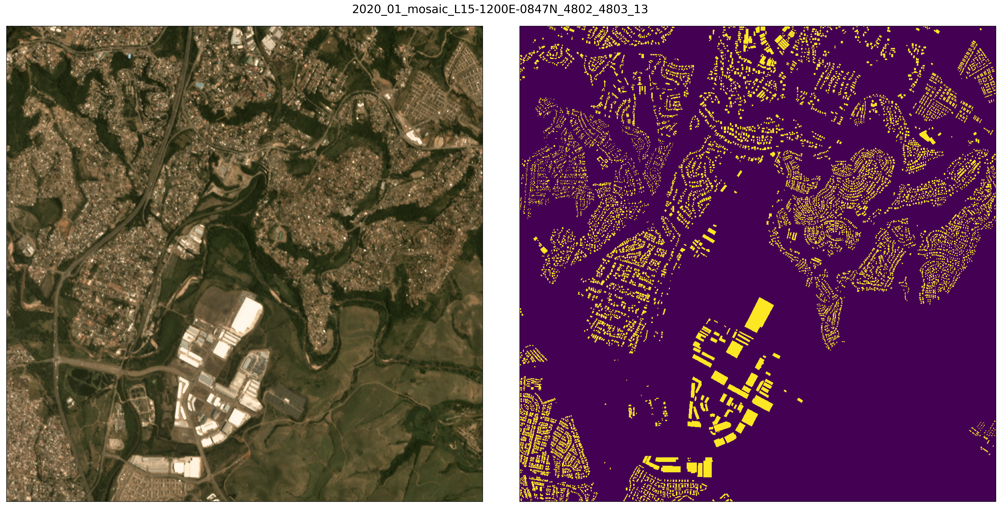

In [3]:
# Inspect visually

aoi = 'L15-1200E-0847N_4802_4803_13'
im_dir = os.path.join(root_dir, 'test_public', aoi, 'images_masked')
gt_dir = os.path.join(root_dir, 'test_public', aoi, 'masks')

im_list = sorted([z for z in os.listdir(im_dir) if z.endswith('.tif')])
im_file = im_list[-1]

im_path = os.path.join(im_dir, im_file)
gt_path = os.path.join(gt_dir, im_file).replace('.tif', '_Buildings.tif')
print(gt_path)
im = skimage.io.imread(im_path)
gt = skimage.io.imread(gt_path)
print(gt)
print("gt.shape:", gt.shape)
print("min, max, mean gt:", np.min(gt), np.max(gt), np.mean(gt))

figsize=(24, 12)
name = im_file.split('.')[0].split('global_monthly_')[-1]
fig, (ax0, ax1) = plt.subplots(1, 2, figsize=figsize)
_ = ax0.imshow(im)
ax0.set_xticks([])
ax0.set_yticks([])
# _ = ax0.set_title(name)
_ = ax1.imshow(gt)
ax1.set_xticks([])
ax1.set_yticks([])
# _ = ax1.set_title(name)
_ = fig.suptitle(name)
plt.tight_layout()

['global_monthly_2018_02_mosaic_L15-1200E-0847N_4802_4803_13.tif', 'global_monthly_2018_03_mosaic_L15-1200E-0847N_4802_4803_13.tif', 'global_monthly_2018_04_mosaic_L15-1200E-0847N_4802_4803_13.tif', 'global_monthly_2018_05_mosaic_L15-1200E-0847N_4802_4803_13.tif', 'global_monthly_2018_06_mosaic_L15-1200E-0847N_4802_4803_13.tif', 'global_monthly_2018_07_mosaic_L15-1200E-0847N_4802_4803_13.tif', 'global_monthly_2018_08_mosaic_L15-1200E-0847N_4802_4803_13.tif', 'global_monthly_2018_09_mosaic_L15-1200E-0847N_4802_4803_13.tif', 'global_monthly_2018_10_mosaic_L15-1200E-0847N_4802_4803_13.tif', 'global_monthly_2018_11_mosaic_L15-1200E-0847N_4802_4803_13.tif', 'global_monthly_2018_12_mosaic_L15-1200E-0847N_4802_4803_13.tif', 'global_monthly_2019_01_mosaic_L15-1200E-0847N_4802_4803_13.tif', 'global_monthly_2019_02_mosaic_L15-1200E-0847N_4802_4803_13.tif', 'global_monthly_2019_03_mosaic_L15-1200E-0847N_4802_4803_13.tif', 'global_monthly_2019_04_mosaic_L15-1200E-0847N_4802_4803_13.tif', 'global_m

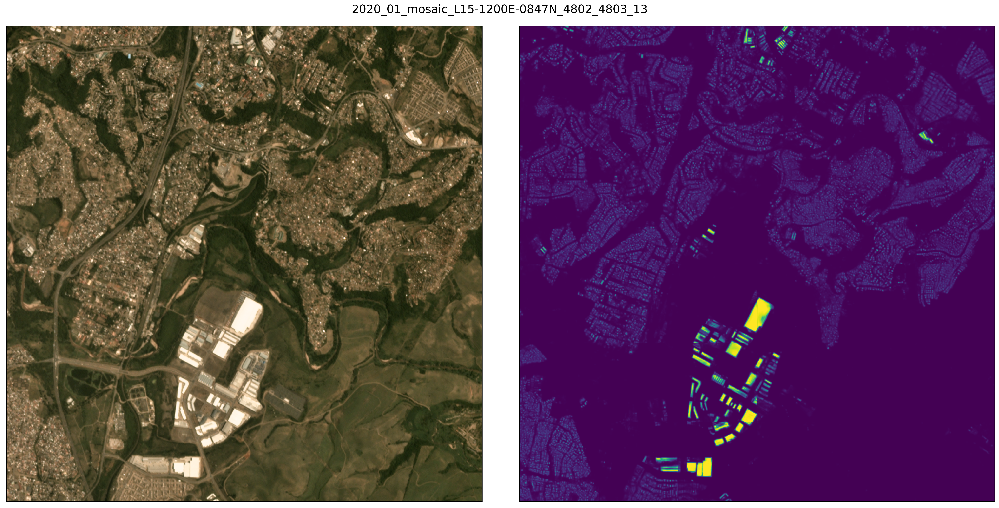

In [4]:
# Inspect visually

aoi = 'L15-1200E-0847N_4802_4803_13'
im_dir = os.path.join(root_dir, 'test_public', aoi, 'images_masked')

im_list = sorted([z for z in os.listdir(im_dir) if z.endswith('.tif')])
print(im_list)
im_file = im_list[-1]

im_path = os.path.join(im_dir, im_file)
mask_path = os.path.join(pred_dir, im_file.split('.')[0] + '.npy')
print(mask_path)
im = skimage.io.imread(im_path)
mask = np.load(mask_path)
norm = (mask - np.min(mask)) / (np.max(mask) - np.min(mask))
print(norm)
print("mask.shape:", norm.shape)
print("min, max, mean mask:", np.min(norm), np.max(norm), np.mean(norm))

figsize=(24, 12)
name = im_file.split('.')[0].split('global_monthly_')[-1]
fig, (ax0, ax1) = plt.subplots(1, 2, figsize=figsize)
_ = ax0.imshow(im)
ax0.set_xticks([])
ax0.set_yticks([])
# _ = ax0.set_title(name)
_ = ax1.imshow(norm)
ax1.set_xticks([])
ax1.set_yticks([])
# _ = ax1.set_title(name)
_ = fig.suptitle(name)
plt.tight_layout()

['global_monthly_2018_02_mosaic_L15-1200E-0847N_4802_4803_13.tif', 'global_monthly_2018_03_mosaic_L15-1200E-0847N_4802_4803_13.tif', 'global_monthly_2018_04_mosaic_L15-1200E-0847N_4802_4803_13.tif', 'global_monthly_2018_05_mosaic_L15-1200E-0847N_4802_4803_13.tif', 'global_monthly_2018_06_mosaic_L15-1200E-0847N_4802_4803_13.tif', 'global_monthly_2018_07_mosaic_L15-1200E-0847N_4802_4803_13.tif', 'global_monthly_2018_08_mosaic_L15-1200E-0847N_4802_4803_13.tif', 'global_monthly_2018_09_mosaic_L15-1200E-0847N_4802_4803_13.tif', 'global_monthly_2018_10_mosaic_L15-1200E-0847N_4802_4803_13.tif', 'global_monthly_2018_11_mosaic_L15-1200E-0847N_4802_4803_13.tif', 'global_monthly_2018_12_mosaic_L15-1200E-0847N_4802_4803_13.tif', 'global_monthly_2019_01_mosaic_L15-1200E-0847N_4802_4803_13.tif', 'global_monthly_2019_02_mosaic_L15-1200E-0847N_4802_4803_13.tif', 'global_monthly_2019_03_mosaic_L15-1200E-0847N_4802_4803_13.tif', 'global_monthly_2019_04_mosaic_L15-1200E-0847N_4802_4803_13.tif', 'global_m

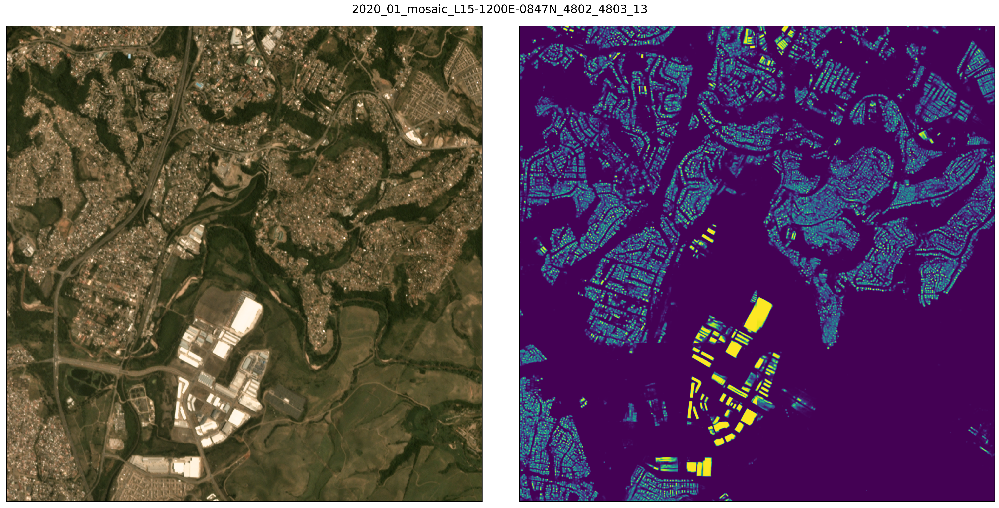

In [5]:
# Inspect visually

aoi = 'L15-1200E-0847N_4802_4803_13'
im_dir = os.path.join(root_dir, 'test_public', aoi, 'images_masked')

im_list = sorted([z for z in os.listdir(im_dir) if z.endswith('.tif')])
print(im_list)
im_file = im_list[-1]

im_path = os.path.join(im_dir, im_file)
mask_path = os.path.join(winner_dir, im_file.split('.')[0] + '.npy')
print(mask_path)
im = skimage.io.imread(im_path)
mask = np.load(mask_path)
print(mask)
print("mask.shape:", mask.shape)
print("min, max, mean mask:", np.min(mask), np.max(mask), np.mean(mask))

figsize=(24, 12)
name = im_file.split('.')[0].split('global_monthly_')[-1]
fig, (ax0, ax1) = plt.subplots(1, 2, figsize=figsize)
_ = ax0.imshow(im)
ax0.set_xticks([])
ax0.set_yticks([])
# _ = ax0.set_title(name)
_ = ax1.imshow(mask)
ax1.set_xticks([])
ax1.set_yticks([])
# _ = ax1.set_title(name)
_ = fig.suptitle(name)
plt.tight_layout()

/local_storage/datasets/sn7_winner_split/test_public/L15-1615E-1206N_6460_3366_13/masks/global_monthly_2019_09_mosaic_L15-1615E-1206N_6460_3366_13_Buildings.tif
[[  0   0   0 ...   0   0   0]
 [  0 255 255 ...   0   0   0]
 [255 255 255 ...   0   0   0]
 ...
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]]
gt.shape: (1024, 1024)
min, max, mean gt: 0 255 12.435364723205566


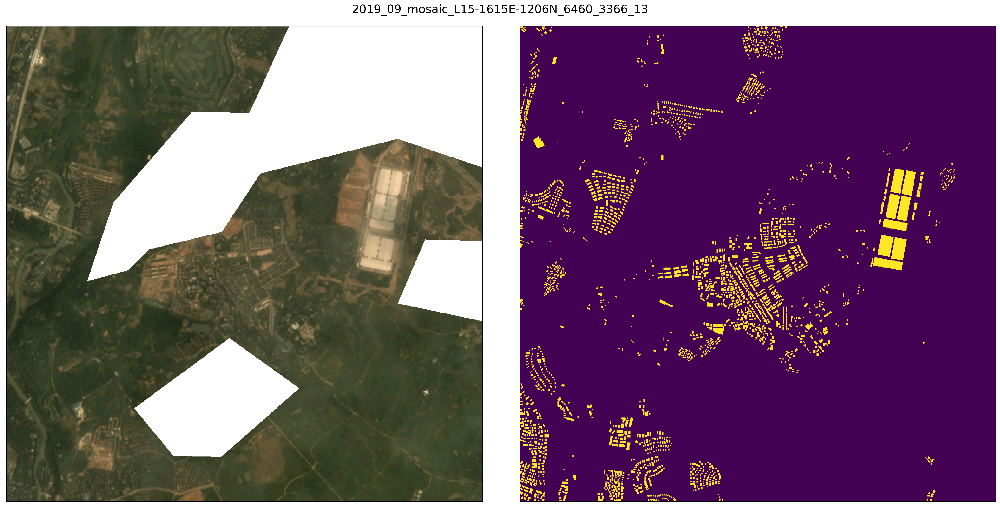

In [6]:
# Inspect visually

aoi = 'L15-1615E-1206N_6460_3366_13'
im_dir = os.path.join(root_dir, 'test_public', aoi, 'images_masked')
gt_dir = os.path.join(root_dir, 'test_public', aoi, 'masks')

im_list = sorted([z for z in os.listdir(im_dir) if z.endswith('.tif')])
im_file = im_list[-1]

im_path = os.path.join(im_dir, im_file)
gt_path = os.path.join(gt_dir, im_file).replace('.tif', '_Buildings.tif')
print(gt_path)
im = skimage.io.imread(im_path)
gt = skimage.io.imread(gt_path)
print(gt)
print("gt.shape:", gt.shape)
print("min, max, mean gt:", np.min(gt), np.max(gt), np.mean(gt))

figsize=(24, 12)
name = im_file.split('.')[0].split('global_monthly_')[-1]
fig, (ax0, ax1) = plt.subplots(1, 2, figsize=figsize)
_ = ax0.imshow(im)
ax0.set_xticks([])
ax0.set_yticks([])
# _ = ax0.set_title(name)
_ = ax1.imshow(gt)
ax1.set_xticks([])
ax1.set_yticks([])
# _ = ax1.set_title(name)
_ = fig.suptitle(name)
plt.tight_layout()

In [ ]:
# Inspect visually

aoi = 'L15-1615E-1206N_6460_3366_13'
im_dir = os.path.join(root_dir, 'test_public', aoi, 'images_masked')

im_list = sorted([z for z in os.listdir(im_dir) if z.endswith('.tif')])
print(im_list)
im_file = im_list[-1]

im_path = os.path.join(im_dir, im_file)
mask_path = os.path.join(pred_dir, im_file.split('.')[0] + '.npy')
print(mask_path)
im = skimage.io.imread(im_path)
mask = np.load(mask_path)

figsize=(24, 12)
name = im_file.split('.')[0].split('global_monthly_')[-1]
fig, (ax0, ax1) = plt.subplots(1, 2, figsize=figsize)
_ = ax0.imshow(im)
ax0.set_xticks([])
ax0.set_yticks([])
# _ = ax0.set_title(name)
_ = ax1.imshow(mask)
ax1.set_xticks([])
ax1.set_yticks([])
# _ = ax1.set_title(name)
_ = fig.suptitle(name)
plt.tight_layout()

['global_monthly_2017_07_mosaic_L15-1615E-1206N_6460_3366_13.tif', 'global_monthly_2017_08_mosaic_L15-1615E-1206N_6460_3366_13.tif', 'global_monthly_2017_09_mosaic_L15-1615E-1206N_6460_3366_13.tif', 'global_monthly_2017_10_mosaic_L15-1615E-1206N_6460_3366_13.tif', 'global_monthly_2017_11_mosaic_L15-1615E-1206N_6460_3366_13.tif', 'global_monthly_2018_01_mosaic_L15-1615E-1206N_6460_3366_13.tif', 'global_monthly_2018_02_mosaic_L15-1615E-1206N_6460_3366_13.tif', 'global_monthly_2018_03_mosaic_L15-1615E-1206N_6460_3366_13.tif', 'global_monthly_2018_04_mosaic_L15-1615E-1206N_6460_3366_13.tif', 'global_monthly_2018_05_mosaic_L15-1615E-1206N_6460_3366_13.tif', 'global_monthly_2018_06_mosaic_L15-1615E-1206N_6460_3366_13.tif', 'global_monthly_2018_07_mosaic_L15-1615E-1206N_6460_3366_13.tif', 'global_monthly_2018_08_mosaic_L15-1615E-1206N_6460_3366_13.tif', 'global_monthly_2018_09_mosaic_L15-1615E-1206N_6460_3366_13.tif', 'global_monthly_2018_10_mosaic_L15-1615E-1206N_6460_3366_13.tif', 'global_m

In [ ]:
# Inspect visually

aoi = 'L15-1615E-1206N_6460_3366_13'
im_dir = os.path.join(root_dir, 'test_public', aoi, 'images_masked')

im_list = sorted([z for z in os.listdir(im_dir) if z.endswith('.tif')])
print(im_list)
im_file = im_list[-1]

im_path = os.path.join(im_dir, im_file)
mask_path = os.path.join(winner_dir, im_file.split('.')[0] + '.npy')
print(mask_path)
im = skimage.io.imread(im_path)
mask = np.load(mask_path)
print(mask)
print("mask.shape:", mask.shape)
print("min, max, mean mask:", np.min(mask), np.max(mask), np.mean(mask))

figsize=(24, 12)
name = im_file.split('.')[0].split('global_monthly_')[-1]
fig, (ax0, ax1) = plt.subplots(1, 2, figsize=figsize)
_ = ax0.imshow(im)
ax0.set_xticks([])
ax0.set_yticks([])
# _ = ax0.set_title(name)
_ = ax1.imshow(mask)
ax1.set_xticks([])
ax1.set_yticks([])
# _ = ax1.set_title(name)
_ = fig.suptitle(name)
plt.tight_layout()